# Импорты

In [20]:
from os.path import join as pjoin
import os, cv2
import re
import random, tqdm

import pandas as pd
import numpy as np
from collections import Counter

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchinfo
from torch.utils.data import Dataset, DataLoader
from  torch.optim.lr_scheduler import ReduceLROnPlateau
from torchmetrics.classification import MulticlassAccuracy, MulticlassF1Score, MulticlassPrecision, MulticlassRecall
from segmentation_models_pytorch import utils

import torchvision.transforms as transforms
import torchvision

import torchmetrics.classification as metrics

import matplotlib.pyplot as plt

# -----------------------------------------
import seaborn as sns
from segmentation_models_pytorch import utils

import warnings
warnings.filterwarnings("ignore")

from torch.utils.data import DataLoader
import albumentations as album

import segmentation_models_pytorch as smp

# Описание

В данной работа позволяет попрактиковаться по задачам на сегментацию. Сегментация дорог по аэрофотоснимкам Препятствия из-за близлежащих деревьев, тени от соседних зданий, различная текстура и цвет дорог, дисбаланс классов дорог.

ссылка на задачу - https://www.kaggle.com/datasets/balraj98/massachusetts-roads-dataset

# Константы

In [21]:
DATA_DIR = 'data/tiff/'
DATA_CLASSES = "data/label_class_dict.csv"

DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Функции

In [22]:
# Построение изображений в один ряд
def visualize(**images):
    n_images = len(images)
    plt.figure(figsize=(13, 4))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(name.replace('_', ' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

# Преобразуйте массив меток изображения с сегментацией в формат one-hot заменив значение каждого пикселя вектором длины num_classes
def one_hot_encode(label, label_values):
    semantic_map = []
    for colour in label_values:
        equality = np.equal(label, colour)
        class_map = np.all(equality, axis=-1)
        semantic_map.append(class_map)
    semantic_map = np.stack(semantic_map, axis=-1)
    return semantic_map

# Преобразуйте 2D-массив в одноразовом формате (глубина равна num_classes) в 2D-массив только с 1 каналом,
# где каждое значение пикселя является ключом классифицированного класса.
def reverse_one_hot(image):
    x = np.argmax(image, axis=-1)
    return x

# Учитывая 1-канальный массив ключей класса, цветовое кодирование результатов сегментации.
# Изображение аргументов: одноканальный массив, где каждое значение представляет ключ класса.
def colour_code_segmentation(image, label_values):
    color_codes = np.array(label_values)
    x = color_codes[image.astype(int)]
    return x

def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


# Классы

In [23]:
class RoadsDataset(Dataset):

    def __init__(
            self,
            images_dir,
            masks_dir,
            class_rgb_values=None,
            augmentation=None,
            preprocessing=None,
    ):
        self.image_paths = [os.path.join(
            images_dir, image_id) for image_id in sorted(os.listdir(images_dir))]
        self.mask_paths = [os.path.join(masks_dir, image_id)
                           for image_id in sorted(os.listdir(masks_dir))]

        self.class_rgb_values = class_rgb_values
        self.augmentation = augmentation
        self.preprocessing = preprocessing

    def __getitem__(self, i):
        image = cv2.cvtColor(cv2.imread(
            self.image_paths[i]), cv2.COLOR_BGR2RGB)
        mask = cv2.cvtColor(cv2.imread(self.mask_paths[i]), cv2.COLOR_BGR2RGB)
        mask = one_hot_encode(mask, self.class_rgb_values).astype('float')

        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        return image, mask

    def __len__(self):
        # return length of
        return len(self.image_paths)


# Параметры для загрузки данных

In [24]:
x_train_dir = os.path.join(DATA_DIR, 'train')
y_train_dir = os.path.join(DATA_DIR, 'train_labels')

x_valid_dir = os.path.join(DATA_DIR, 'val')
y_valid_dir = os.path.join(DATA_DIR, 'val_labels')

x_test_dir = os.path.join(DATA_DIR, 'test')
y_test_dir = os.path.join(DATA_DIR, 'test_labels')

class_dict = pd.read_csv(DATA_CLASSES)
# Классы
CLASSES = class_dict['name'].tolist()
# Классы RGB значений
CLASSES_RGB = class_dict[['r','g','b']].values.tolist()

print('Все классы и соответствующие им значения RGB')
print('Классы: ', CLASSES)
print('Классы RGB значений: ', CLASSES_RGB)

Все классы и соответствующие им значения RGB
Классы:  ['background', 'road']
Классы RGB значений:  [[0, 0, 0], [255, 255, 255]]


# Работа с картинками (Демо)

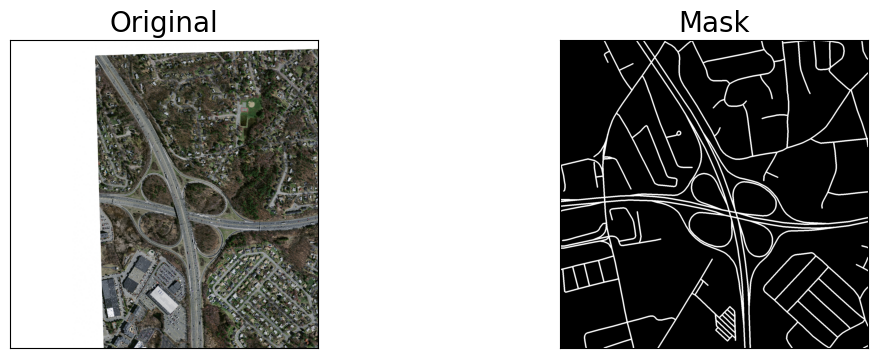

In [31]:
dataset = RoadsDataset(x_train_dir, y_train_dir, class_rgb_values=CLASSES_RGB)
random_idx = random.randint(0, len(dataset)-1)

for i in range(1):
    random_idx = random.randint(0, len(dataset)-1)
    image, mask = dataset[random_idx]
    
    visualize(
        original = image,
        mask = colour_code_segmentation(reverse_one_hot(mask), CLASSES_RGB),
    )

# Гипер-параметры

In [8]:
EPOCHS = 5
LEARNING_RATE = 0.001
BATCH_SIZE = 32
N_WORKERS = 0

MEAN_IMAGE_TRANSFORM = [0.4363, 0.4328, 0.3291]
MEAN_IMAGE_STD = [0.2129, 0.2075, 0.2038]
SIZE_IMAGE = 256

# Параметры преобразования изображения

In [9]:
def get_training_augmentation():
    train_transform = [
        album.RandomCrop(height=SIZE_IMAGE, width=SIZE_IMAGE,
                         always_apply=True),
        album.OneOf(
            [
                album.HorizontalFlip(p=1),
                album.VerticalFlip(p=1),
                album.RandomRotate90(p=1),
            ],
            p=0.75,
        ),
        # album.Normalize(mean=MEAN_IMAGE_TRANSFORM,
        #                 std=MEAN_IMAGE_STD, always_apply=True)
    ]
    return album.Compose(train_transform)


def get_validation_augmentation():
    test_transform = [
        album.PadIfNeeded(min_height=1536, min_width=1536,
                          always_apply=True, border_mode=0),
    ]
    return album.Compose(test_transform)


def get_preprocessing(preprocessing_fn=None):
    _transform = []
    if preprocessing_fn:
        _transform.append(album.Lambda(image=preprocessing_fn))
    _transform.append(album.Lambda(image=to_tensor, mask=to_tensor))

    return album.Compose(_transform)


# Отображение с аугментацией

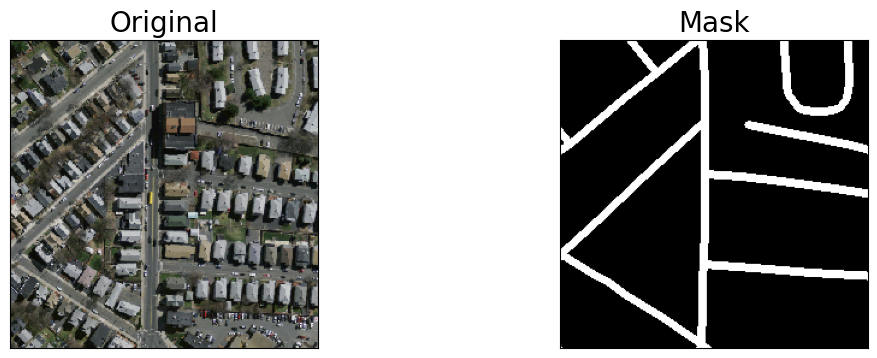

In [10]:
augmented_dataset = RoadsDataset(
    x_train_dir, y_train_dir, 
    augmentation=get_training_augmentation(),
    class_rgb_values=CLASSES_RGB,
)

for i in range(1):
    random_idx = random.randint(0, len(augmented_dataset)-1)
    image, mask = augmented_dataset[random_idx]
    visualize(
        original = image,
        mask = colour_code_segmentation(reverse_one_hot(mask), CLASSES_RGB),
        # oneHotEncoded = reverse_one_hot(mask)
    )

# Модель

In [11]:
ENCODER = 'mobilenet_v2'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = CLASSES
ACTIVATION = nn.ReLU

model = smp.Unet(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=len(CLASSES), 
    activation=ACTIVATION,
).to(DEVICE)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

# Загрузка данныъх

In [12]:
train_dataset = RoadsDataset(
    x_train_dir, y_train_dir,
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=CLASSES_RGB,
)

valid_dataset = RoadsDataset(
    x_valid_dir, y_valid_dir,
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=CLASSES_RGB,
)

train_loader = DataLoader(
    train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=N_WORKERS)
valid_loader = DataLoader(valid_dataset, batch_size=1,
                          shuffle=False, num_workers=0)

# Обучение

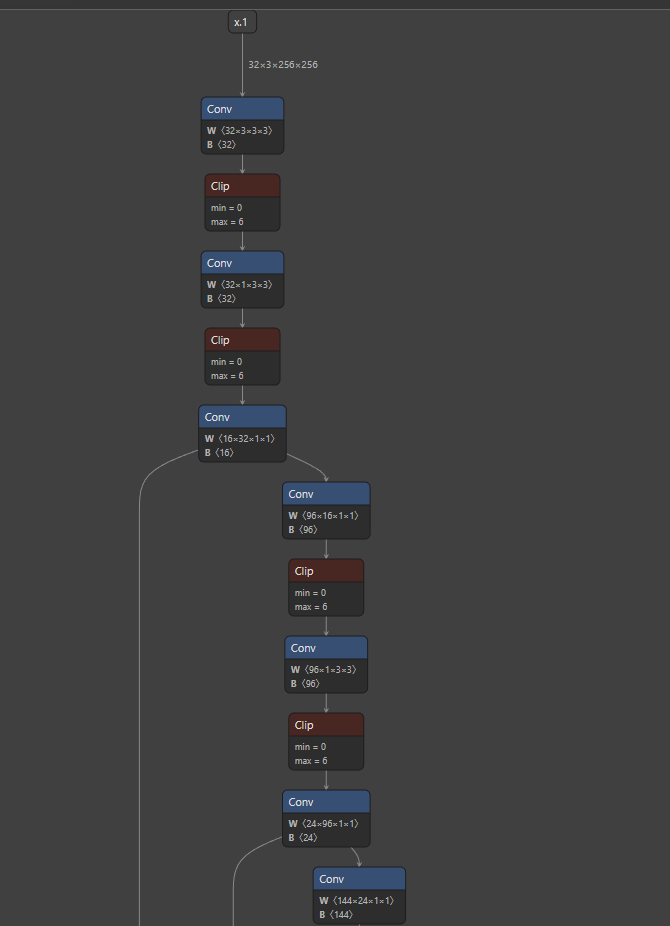

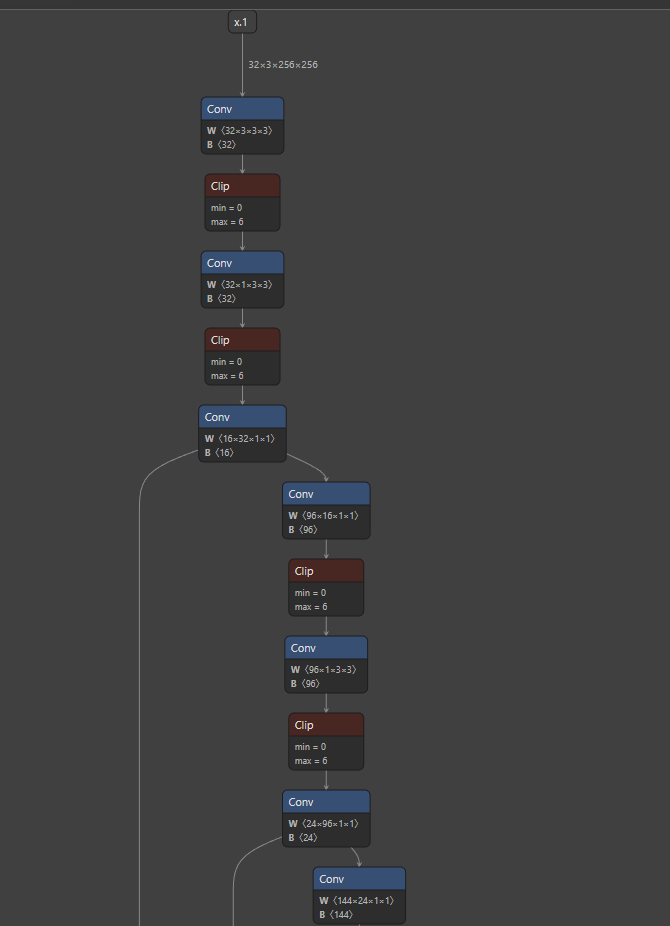


In [13]:
# define loss function
criterion = smp.utils.losses.DiceLoss()

# define metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

# define optimizer
optimizer = torch.optim.Adam(params=model.parameters(), lr=0.00008, weight_decay=0.0001)

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)


In [15]:
# %%time

# best_iou_score = 0.0
# train_logs_list, valid_logs_list = [], []

# for i in range(0, EPOCHS):

#     # Perform training & validation
#     print('\nEpoch: {}'.format(i))
#     train_logs = train_epoch.run(train_loader)
#     print('\train_logs: {}'.format(i))
#     valid_logs = valid_epoch.run(valid_loader)
#     print('\valid_logs: {}'.format(i))
#     train_logs_list.append(train_logs)
#     valid_logs_list.append(valid_logs)

len_steps = len(train_loader)
list_loos = []
# обучение
for epoch in range(EPOCHS):
    list_loos_epoch = []
    # перегрузчик, что бы получить разные партии
    for i, (images, labels) in enumerate(train_loader):
        # получаем поддержку графического процессора
        images = images.to(DEVICE)
        labels = labels.to(DEVICE)

        # проходим вперед
        outputs = model(images)

        # создаем потери
        loss = criterion(outputs, labels)

        # регулизация
        # l2_lambda = 0.001
        # l2_norm = sum(p.pow(2.0).sum() for p in model.parameters())
        # loss = loss + l2_lambda * l2_norm

        list_loos_epoch.append(loss.item())
        # чистка градиента
        optimizer.zero_grad()
        # обратный проход
        loss.backward()
        # оптимизируем шаг
        optimizer.step()
        print(
            f'Epoch [{epoch+1}/{EPOCHS}], step [{i+1}/{len_steps}], loss {loss.item():.4f}')
    # scheduler.step(loss, epoch) # lr <
    list_loos.append(sum(list_loos_epoch) / float(len(list_loos_epoch)))
print("finish")

Epoch [1/5], step [1/35], loss 0.3810
Epoch [1/5], step [2/35], loss 0.3684
Epoch [1/5], step [3/35], loss 0.3594
Epoch [1/5], step [4/35], loss 0.3497
Epoch [1/5], step [5/35], loss 0.3413
Epoch [1/5], step [6/35], loss 0.3343
Epoch [1/5], step [7/35], loss 0.3143
Epoch [1/5], step [8/35], loss 0.2971
Epoch [1/5], step [9/35], loss 0.2896
Epoch [1/5], step [10/35], loss 0.2805
Epoch [1/5], step [11/35], loss 0.2673
Epoch [1/5], step [12/35], loss 0.2549
Epoch [1/5], step [13/35], loss 0.2447
Epoch [1/5], step [14/35], loss 0.2374
Epoch [1/5], step [15/35], loss 0.2242
Epoch [1/5], step [16/35], loss 0.2263
Epoch [1/5], step [17/35], loss 0.2154
Epoch [1/5], step [18/35], loss 0.2005
Epoch [1/5], step [19/35], loss 0.2072
Epoch [1/5], step [20/35], loss 0.1860
Epoch [1/5], step [21/35], loss 0.1835
Epoch [1/5], step [22/35], loss 0.1779
Epoch [1/5], step [23/35], loss 0.1738
Epoch [1/5], step [24/35], loss 0.1608
Epoch [1/5], step [25/35], loss 0.1487
Epoch [1/5], step [26/35], loss 0.

# Тестируем на тестовых данных

# Наглядное отображение

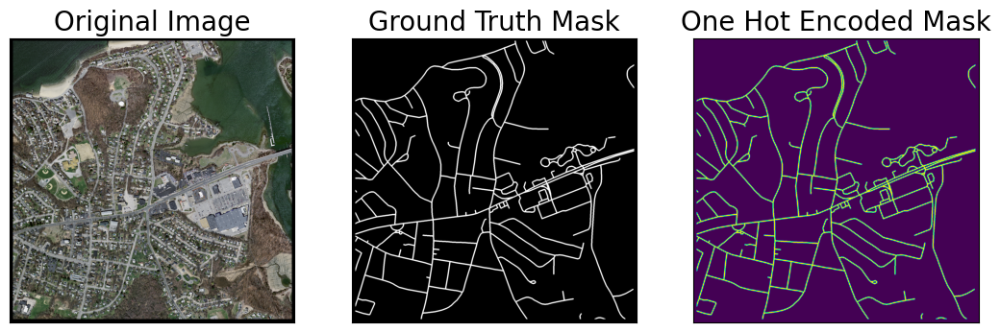

In [16]:
test_dataset = RoadsDataset(
    x_test_dir, 
    y_test_dir, 
    augmentation=get_validation_augmentation(), 
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=CLASSES_RGB,
)

test_dataloader = DataLoader(test_dataset)

# test dataset for visualization (without preprocessing transformations)
test_dataset_vis = RoadsDataset(
    x_test_dir, y_test_dir, 
    augmentation=get_validation_augmentation(),
    class_rgb_values=CLASSES_RGB,
)

# get a random test image/mask index
random_idx = random.randint(0, len(test_dataset_vis)-1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), CLASSES_RGB),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [17]:
# Center crop padded image / mask to original image dims
def crop_image(image, target_image_dims=[1500,1500,3]):
   
    target_size = target_image_dims[0]
    image_size = len(image)
    padding = (image_size - target_size) // 2

    if padding<0:
        return image

    return image[
        padding:image_size - padding,
        padding:image_size - padding,
        :,
    ]

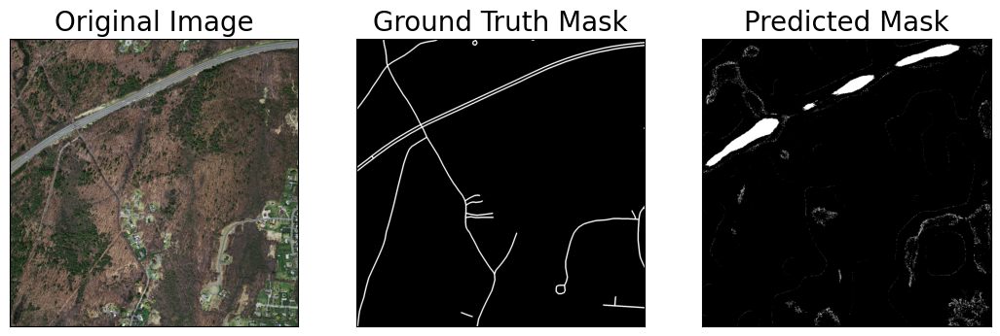

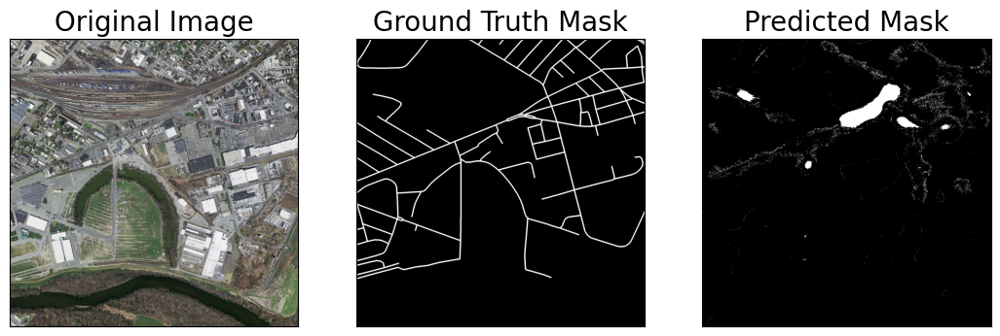

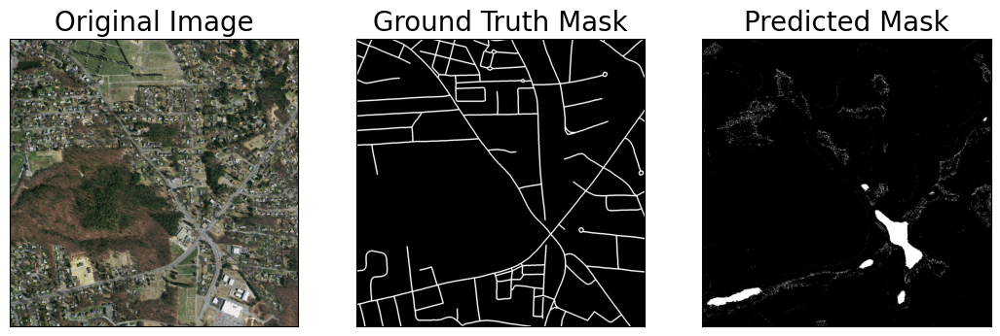

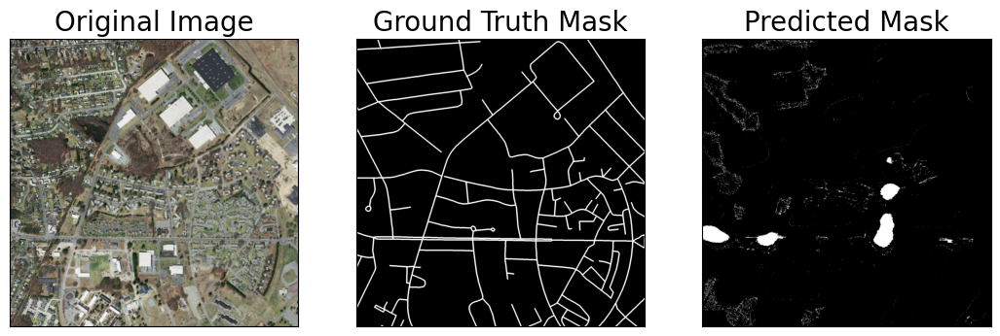

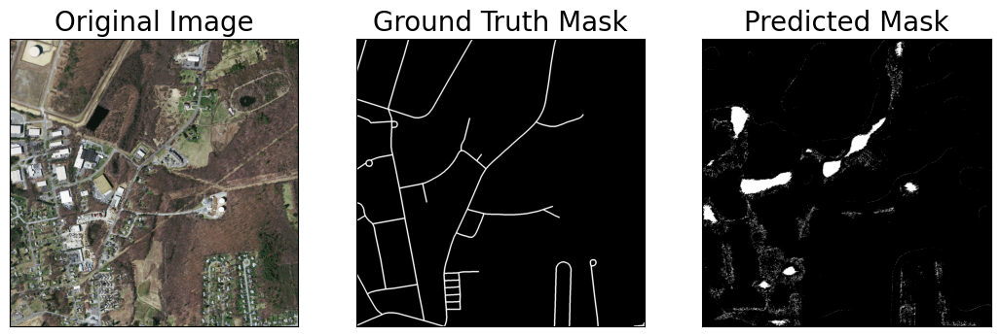

...

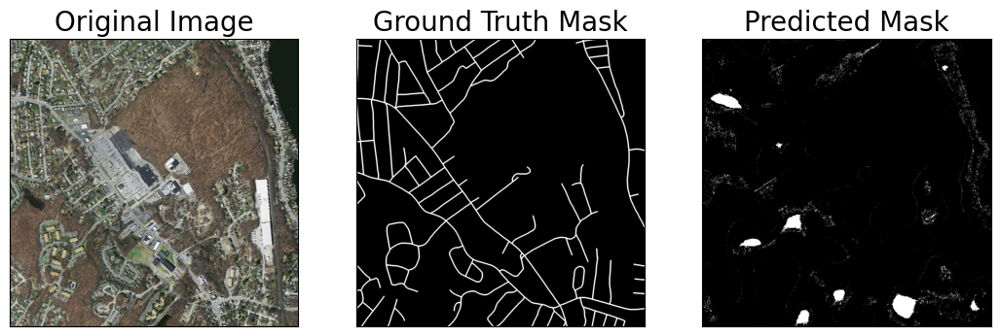

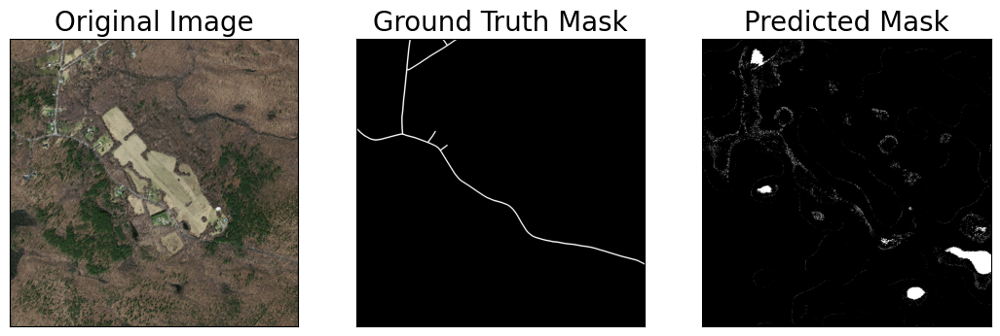

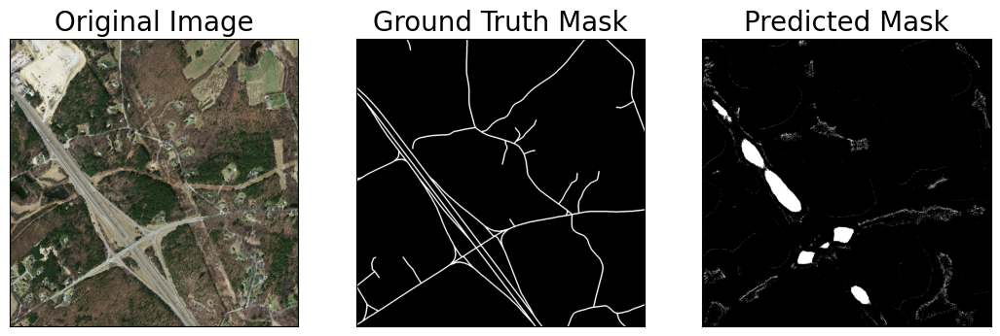

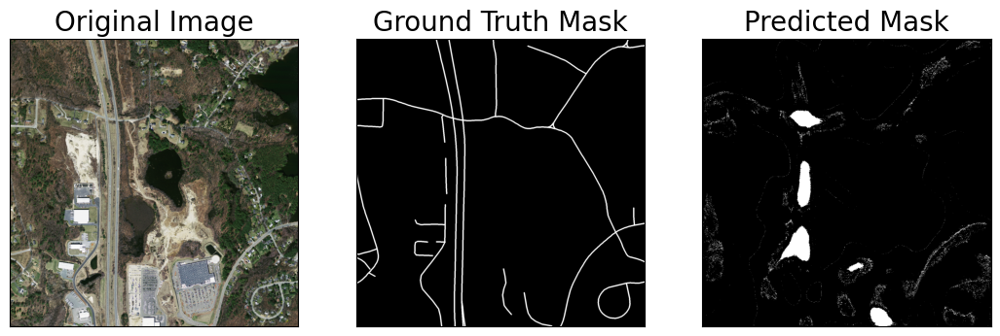

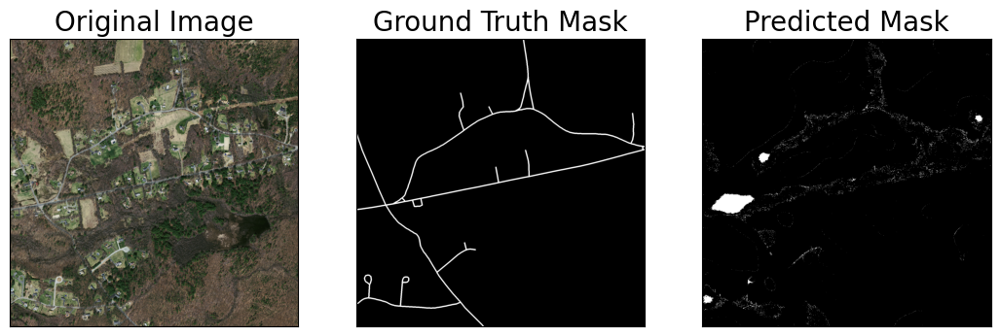

In [18]:
for idx in range(15):

    image, gt_mask = test_dataset[idx]
    image_vis = crop_image(test_dataset_vis[idx][0].astype('uint8'))
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = model(x_tensor)
    pred_mask = pred_mask.detach().squeeze().cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    pred_mask = np.transpose(pred_mask,(1,2,0))

    pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), CLASSES_RGB))
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask,(1,2,0))
    gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), CLASSES_RGB))
    
    visualize(
        original_image = image_vis,
        ground_truth_mask = gt_mask,
        predicted_mask = pred_mask,
    )

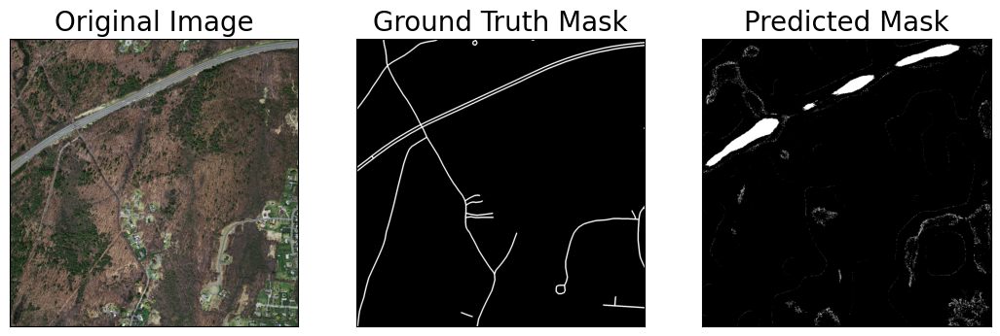

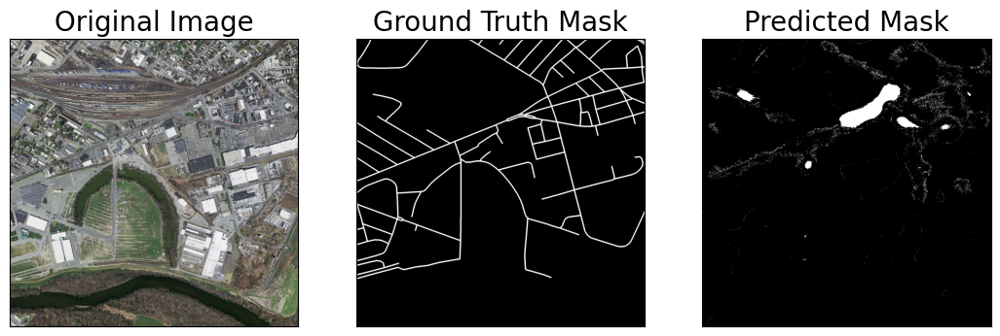

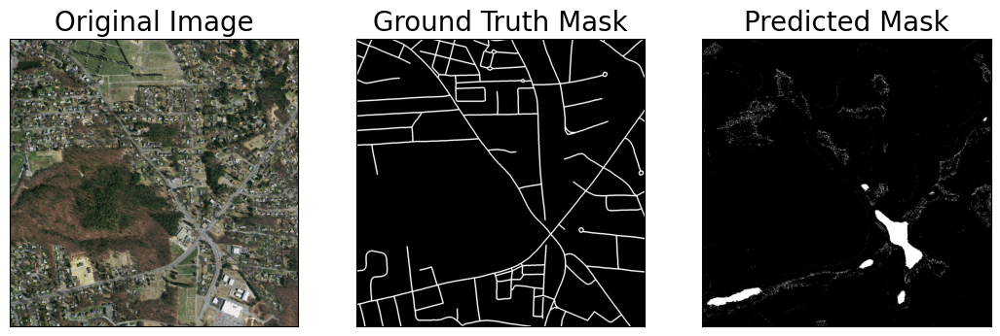

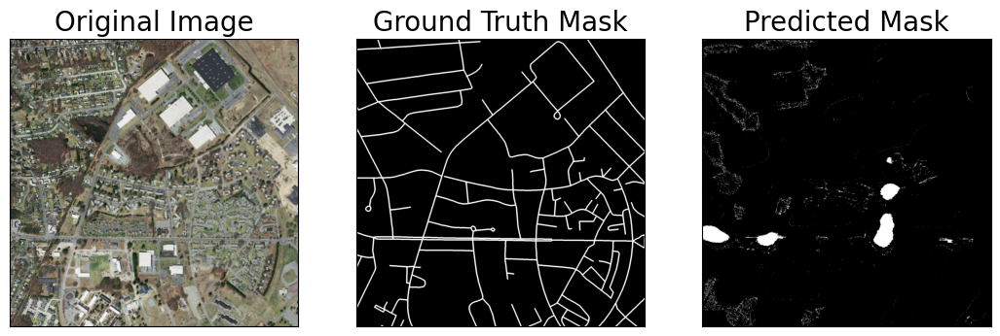

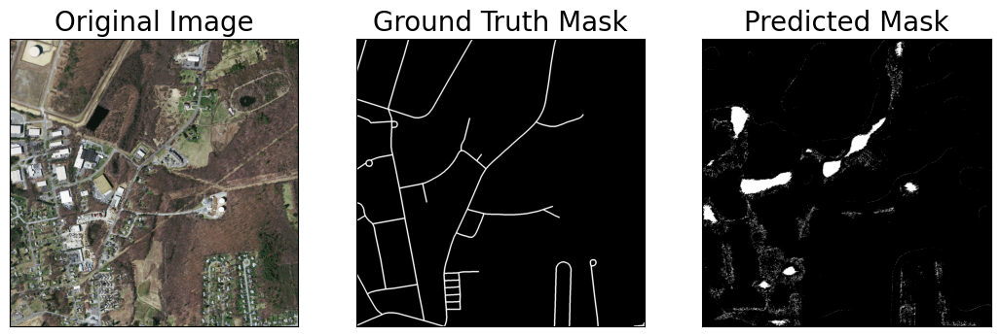

...

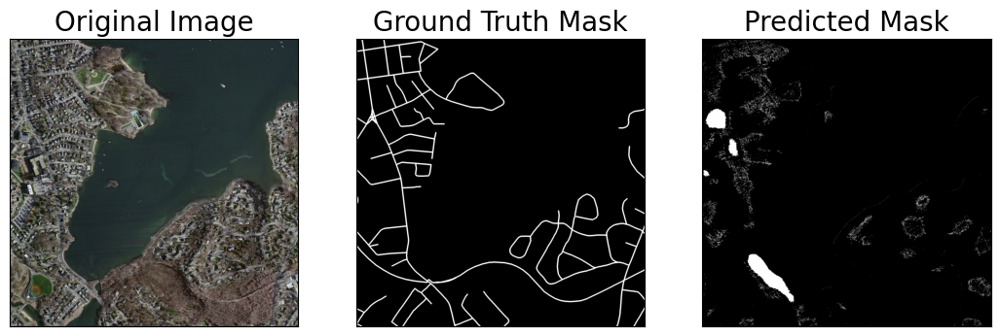

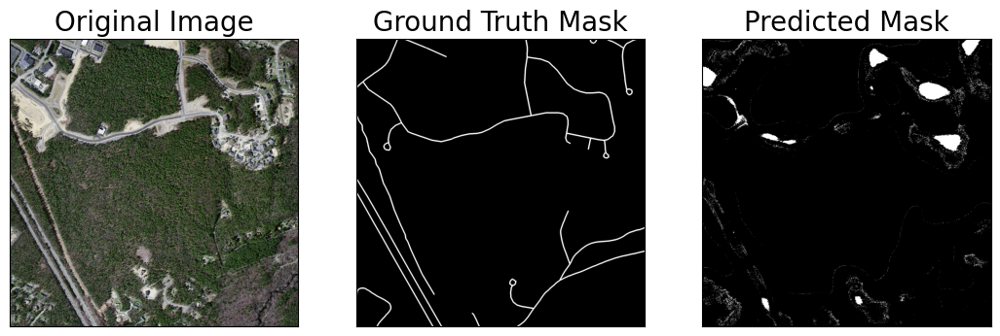

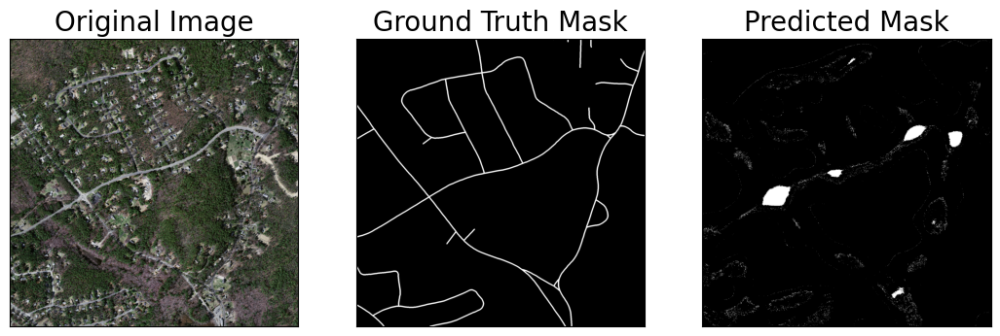

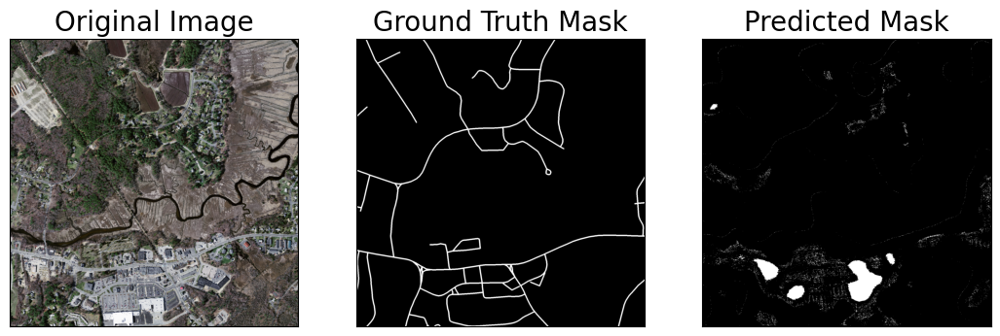

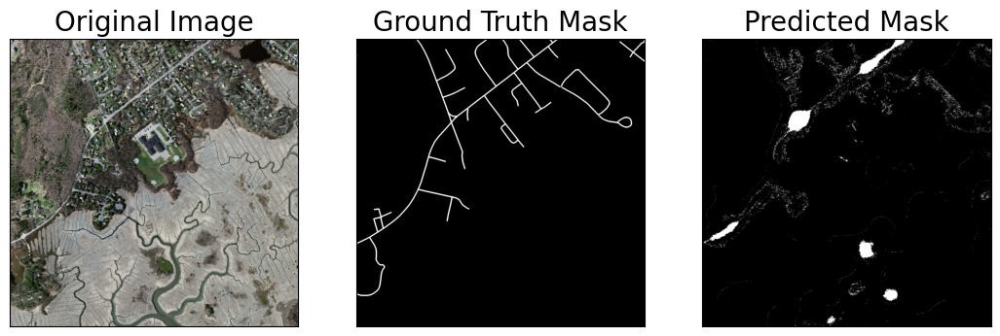

In [19]:
for idx in range(len(test_dataset)):

    image, gt_mask = test_dataset[idx]
    image_vis = crop_image(test_dataset_vis[idx][0].astype('uint8'))
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = model(x_tensor)
    pred_mask = pred_mask.detach().squeeze().cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    pred_mask = np.transpose(pred_mask,(1,2,0))

    pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), CLASSES_RGB))
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask,(1,2,0))
    gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), CLASSES_RGB))
    
    visualize(
        original_image = image_vis,
        ground_truth_mask = gt_mask,
        predicted_mask = pred_mask,
    )